# Project Overview

## Seismic Facies and Structural (faults and fractures) Analysis Using Multiple Seismic Attributes
#### 3D seismic data is playing key role in oil and gas exploration last many decades. Reservoir rocks (Oil and gas storage rock) are heterogenous in nature means rock properties (porosity, permeability, lithology and rock types) vary aerial and vertically but mainly depend the rock depositional processes and later on tectonic activity. In this project, 11 different types of seismic attributes have been used to predict the seismic facies and identify faults & fractures using Machine Learning (ML) techniques (Unsupervised and Supervised). 
#### A seismic facies unit is a sedimentary body (contain same characteristic in term fossils, sedimentary structure, grain color and sizes) which is different from adjacent units in its seismic characteristics. For seismic facies analysis following seismic attributes taken into consideration: Amplitude, Sweetness, Envelope, Polarity, CosPhase, AI,Ampl_Contrast and, Rms_Amplitude. 
#### Combination of these seismic attributes helped to map seismic facies by using Unsupervised and supervised ML Techniques. acies are rock bodies which. The second objective is to identify faults and fracture corridors that are tectonically developed Million of year later after the rock deposition. 
#### Seismic facies and faults & fractures are playing key role in oil and gas production. 



## Problem Statement
#### The main objective of this project is to establish relationship of different seismic attributes that are computed from seismic data at reservoir level and also find the relationship with rock property (porosity, lithology, etc.) to identify the sweet spot of oil and gas wells drilling.

### Metrics

#### Predicted seismic facies are validated at few known locations that are also used in supervised ML classification techniques. ML techniques helps to identify the best reservoir and fractures areas that are directly relate to rock porosity (Storage capacity) and permeability in term of fractures reservoir.      

### Data information:
#### Public domain Seismic data has been used in G&G application and extracted seismic attributes at reservoir level to predict facies and identify the minor discontinuities (minor faults and fractures). Cloudspin and F03 data are available most of G&G applications provided vendors website.
#### In the project two CSV data files have been used. Names of the files are  Seismic_Horizons.csv, Supervised_Horizon_data.csv. These two files contains the Seismic attributes and label data information for supervised ML classifier.  


## Data Exploration

#### Following steps are covered during data exploration task
#### 1:	Import required Python Libraries
#### 2:	Import data set as pandas DataFrame
#### 3:	Check the data Statistic
#### 4:	Check the number of Columns in dataset
#### 5:	Find Null values in data set
#### 6:	Check the Duplicates






In [11]:
# Import Required Libraries
import pandas as pd
import numpy as np 
from pandas import read_csv
from pandas.plotting import scatter_matrix
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
plt.style.use('seaborn-white')
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

# from kneed import KneeLocator

In [12]:
# Import CSV as pandas DataFrame
horizon=pd.read_csv("Seismic_Horizons.csv")
horizon.head(10)

,Unnamed: 0,X,Y,Depth,Dip,Azimuth,Amplitude,Sweetness,Variance,Envople,Polarity,CosPhase,AI,Ampl_Contrast,Rms_Amplitude
0,1,14941.8920,299300.9385,-3302.34,5.20,340.99,-2360.61,5274.50,0.29,5274.50,0.00,-0.45,17672.24,0.48,4027.26
1,2,14941.4860,299303.5995,-3308.13,5.17,5.53,2526.32,3523.99,0.10,3523.99,0.00,0.72,18082.52,0.38,3330.63
2,3,14942.7192,299302.3760,-3305.11,6.17,340.95,3546.38,4657.39,0.22,4657.39,0.32,0.76,17515.05,0.45,2827.58
3,4,14943.9768,299301.1535,-3300.94,5.59,334.10,1972.41,2179.79,0.34,2179.79,0.00,0.93,17765.31,0.49,2047.69
4,5,14945.2072,299299.9315,-3298.15,5.07,326.89,373.42,1835.19,0.23,1835.19,0.00,0.20,18213.53,0.47,2035.99
5,6,14941.1140,299306.2780,-3311.79,3.90,20.00,212.31,3603.03,0.07,3603.03,0.00,0.06,18614.22,0.39,3582.24
6,7,14942.3132,299305.0365,-3310.90,5.50,356.90,2398.76,5483.09,0.01,5483.09,0.00,0.44,18808.84,0.31,4974.53
7,8,14943.5708,299303.8140,-3306.73,6.75,335.66,4074.01,6936.23,0.05,6936.23,0.02,0.59,18579.41,0.32,5053.71
8,9,14944.8284,299302.5915,-3302.56,6.76,339.67,3444.61,4473.77,0.17,4473.77,-0.10,0.77,19014.98,0.44,3150.86
9,10,14946.0848,299301.3705,-3298.71,6.17,334.23,1386.12,1590.20,0.64,1590.20,0.00,0.88,17676.26,0.56,1106.31


In [13]:
# Check the data Statistic
horizon.describe()

,Unnamed: 0,X,Y,Depth,Dip,Azimuth,Amplitude,Sweetness,Variance,Envople,Polarity,CosPhase,AI,Ampl_Contrast,Rms_Amplitude
count,13601.000000,13601.000000,13601.000000,13601.000000,13601.000000,13601.000000,13601.000000,13601.000000,13601.000000,13601.000000,13601.000000,13601.000000,13601.000000,13601.000000,13601.000000
mean,6801.000000,15033.808446,299402.822707,-3172.020971,6.745827,152.758433,3600.825771,7988.766566,0.067161,7988.766566,0.079605,0.418235,17279.014501,0.316876,5685.344426
std,3926.414841,54.467401,61.764344,39.955083,9.613093,105.487422,4925.518224,3189.020500,0.097016,3189.020500,0.281738,0.583570,1251.661059,0.080079,2055.667183
min,1.000000,14938.717600,299297.284500,-3316.420000,0.020000,0.020000,-12517.110000,159.130000,0.000000,159.130000,-1.000000,-1.080000,13844.080000,0.120000,308.420000
25%,3401.000000,14986.620400,299348.040000,-3195.040000,2.450000,52.260000,313.490000,5771.250000,0.020000,5771.250000,0.000000,0.060000,16418.080000,0.260000,4194.990000
50%,6801.000000,15033.683600,299402.548500,-3170.010000,4.320000,160.660000,4164.680000,8141.780000,0.030000,8141.780000,0.000000,0.630000,17330.750000,0.300000,5757.030000
75%,10201.000000,15081.144400,299456.274000,-3146.310000,7.120000,222.000000,7192.690000,10225.620000,0.080000,10225.620000,0.020000,0.900000,18051.810000,0.360000,7154.150000
max,13601.000000,15131.689200,299514.884500,-3082.630000,84.190000,360.000000,18939.340000,19170.110000,0.960000,19170.110000,1.000000,1.080000,26148.870000,0.660000,12745.660000


In [14]:
# Check the number of Columns

horizon.columns

Index(['Unnamed: 0', 'X', 'Y', 'Depth', 'Dip', 'Azimuth', 'Amplitude',
       'Sweetness', 'Variance', 'Envople', 'Polarity', 'CosPhase', 'AI',
       'Ampl_Contrast', 'Rms_Amplitude'],
      dtype='object')

In [15]:
# Check the NUll values in dataFrame
horizon.isnull().sum().sum()

0

In [16]:
# Check the Duplicate Values 
horizon.duplicated()

0        False
1        False
2        False
3        False
4        False
         ...  
13596    False
13597    False
13598    False
13599    False
13600    False
Length: 13601, dtype: bool

In [17]:
# Check the Duplicate Values with repsect to X, Y Columns 
horizon.duplicated(subset=['X','Y'])

0        False
1        False
2        False
3        False
4        False
         ...  
13596    False
13597    False
13598    False
13599    False
13600    False
Length: 13601, dtype: bool

## Data Visualization
#### Following steps are covered during data exploration task
#### 1: Generate Histogram to check the seismic attributes data distribution
#### 2: Generate Heatmap of Seismic Attributes
#### 3: Pairplot of data
#### 4: Check the number of Columns in dataset




array([[<AxesSubplot:title={'center':'Depth'}>,
        <AxesSubplot:title={'center':'Dip'}>,
        <AxesSubplot:title={'center':'Azimuth'}>],
       [<AxesSubplot:title={'center':'Amplitude'}>,
        <AxesSubplot:title={'center':'Sweetness'}>,
        <AxesSubplot:title={'center':'Variance'}>],
       [<AxesSubplot:title={'center':'Envople'}>,
        <AxesSubplot:title={'center':'Polarity'}>,
        <AxesSubplot:title={'center':'CosPhase'}>],
       [<AxesSubplot:title={'center':'AI'}>,
        <AxesSubplot:title={'center':'Ampl_Contrast'}>,
        <AxesSubplot:title={'center':'Rms_Amplitude'}>]], dtype=object)

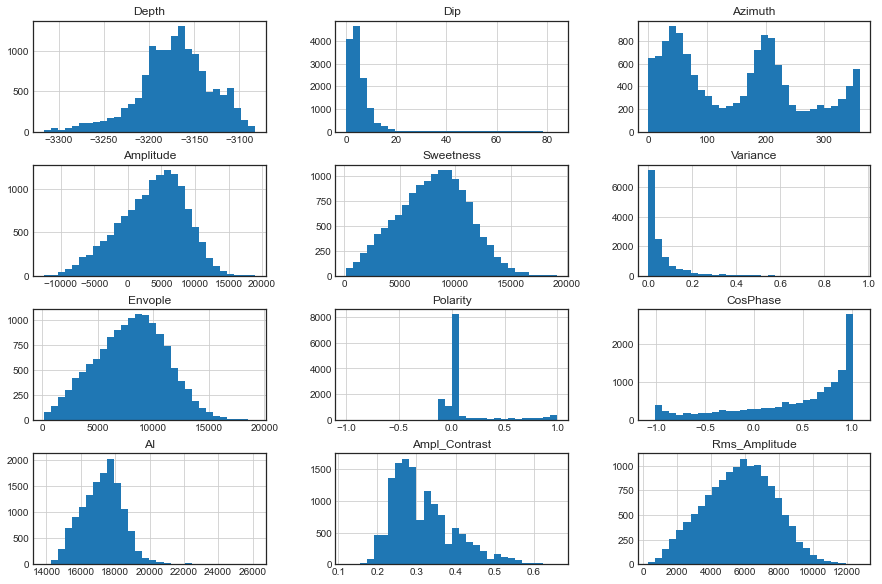

In [18]:
# Histrogram Plot of all columns, only drop first 3 columns

horizon.drop(['Unnamed: 0', 'X', 'Y',], axis=1).hist(bins=30, figsize=(15, 10))

In [19]:
# Create Correlation Function to generate heat map. Here we alss drop first four columns only to analyze Seismic attributes

corr_horizon=horizon.corr()
heatmap_horizon=corr_horizon.drop(['Unnamed: 0', 'X', 'Y','Depth',]).drop(['Unnamed: 0', 'X', 'Y','Depth'],axis=1)

<AxesSubplot:>

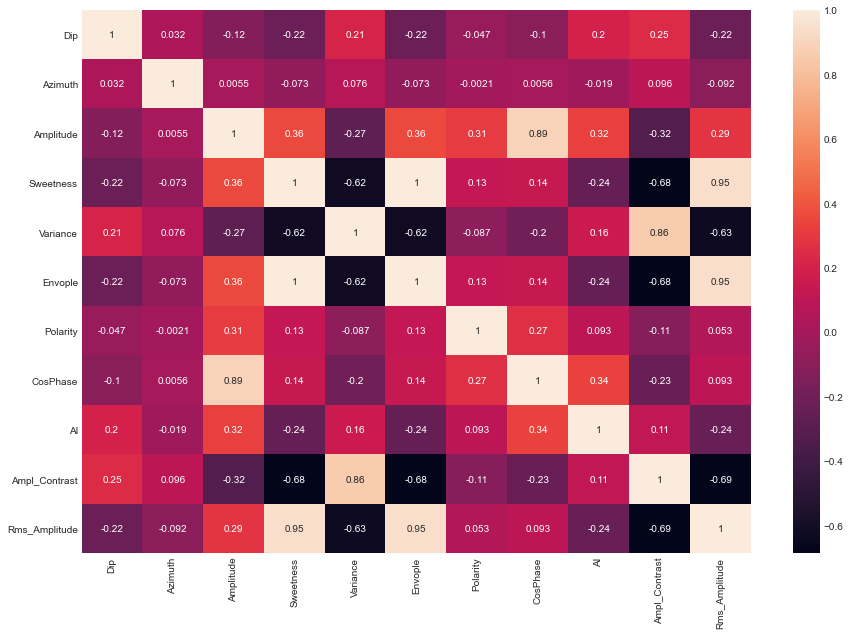

In [20]:
# Heatmap plot using seaborn Library

plt.figure(figsize=(15, 10))
sns.heatmap(heatmap_horizon, annot=True)

#### I observed there two set of seismic attributes that are having good correlation with each other.
#### On the basis heatmap, data need to two divided into two groups.
#### Stratigraphic group (strata) : Amplitude, Sweetness, Envelope, Polarity, AI, CosPhase, Ampl_Contrast and RMS_amplitude good correlation between each other
##### Structural Group (Structure): Dip,Azimuth,Variance,CosPhase,Ampl_Contrast Good correlation between each other


In [21]:
# Split data into Stratighrahic group

strata= horizon.iloc[:,[6,7,9,10,11,12,13,14,]] 
strata.head()

,Amplitude,Sweetness,Envople,Polarity,CosPhase,AI,Ampl_Contrast,Rms_Amplitude
0,-2360.61,5274.50,5274.50,0.00,-0.45,17672.24,0.48,4027.26
1,2526.32,3523.99,3523.99,0.00,0.72,18082.52,0.38,3330.63
2,3546.38,4657.39,4657.39,0.32,0.76,17515.05,0.45,2827.58
3,1972.41,2179.79,2179.79,0.00,0.93,17765.31,0.49,2047.69
4,373.42,1835.19,1835.19,0.00,0.20,18213.53,0.47,2035.99


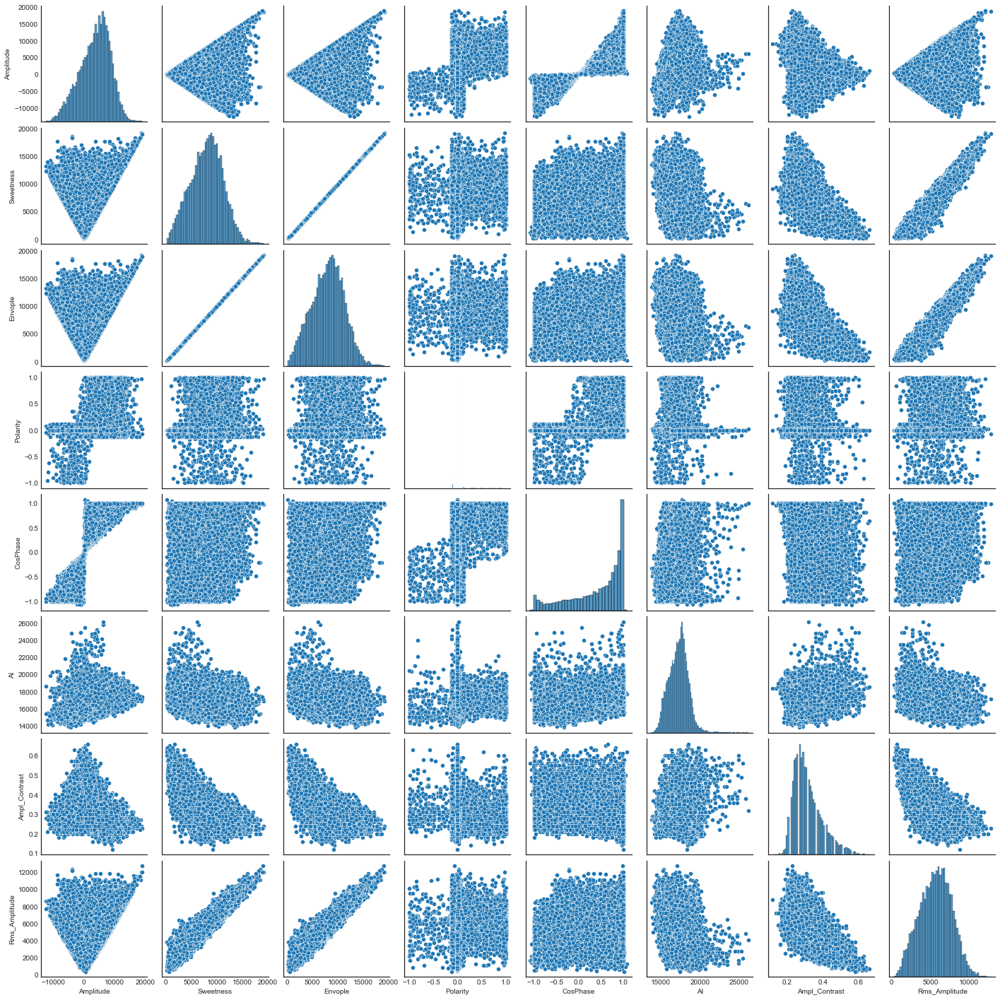

In [22]:
# Stratighrahic group pairplot to view correlation and distrubution in one plot

sns.pairplot(strata)

In [23]:
# Split data into Strcuture group
structure= horizon.iloc[:,[4,5,8,11,13]] 
structure.head(5)

,Dip,Azimuth,Variance,CosPhase,Ampl_Contrast
0,5.20,340.99,0.29,-0.45,0.48
1,5.17,5.53,0.10,0.72,0.38
2,6.17,340.95,0.22,0.76,0.45
3,5.59,334.10,0.34,0.93,0.49
4,5.07,326.89,0.23,0.20,0.47


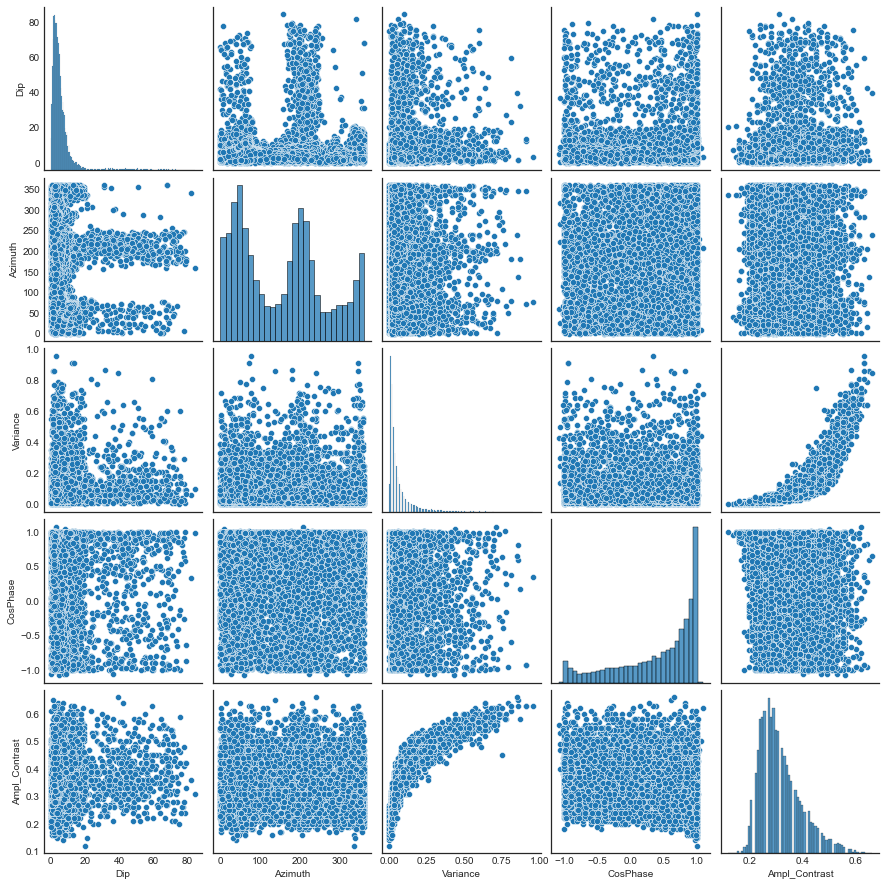

In [24]:
# Structural group paairsplot to view correlation and distrubution in one plot

sns.pairplot(structure)

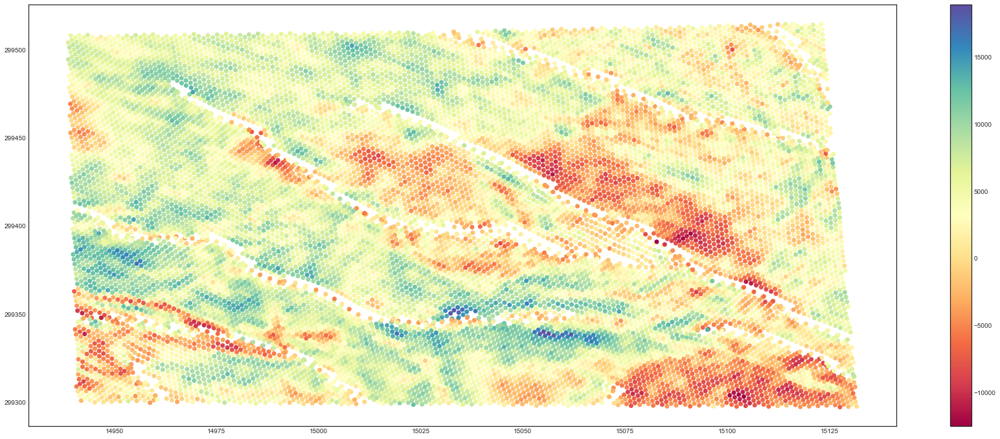

In [25]:
# Seismic amplitude map display with respect to X,Y location
plt.figure(figsize=(30,12))
plt.scatter(horizon.X,horizon.Y,c=horizon.Amplitude,cmap='Spectral')
plt.colorbar()
plt.show()

### In the above figure Red color represents the good reservoir quality . 

### 

## Methodology

### Un-Supervised and Supervised Machine Learning Techniques are used to reveal geological features from data.

### Data Preprocessing

#### In this task, data is divided into two groups (strata and Structural). Second, data is scaled before using in ML classification technique. Some scatter plots are created to analyze the variables relationship. No other data reprocessing task is required because data is already cleaned form when exported from G&G application. 


In [26]:
import matplotlib.pyplot as plt
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler
# from kneed import KneeLocator

## Un-Supervised Machine Learning

### Implementation

#### First, I used the KMeans clustering techniques to find the number of data clusters on the basis of different variables which can be used to identify the good reservoir and fault & fractures zones. 


## Stratigraphic Analysis

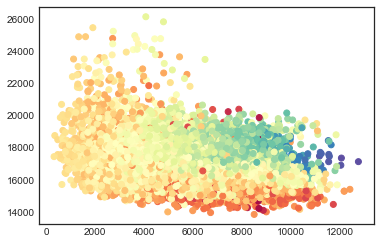

In [27]:
# Scatter plot RMS_amplitude and AI and color coded with Amplitude.

plt.scatter(strata['Rms_Amplitude'], strata['AI'], c=horizon.Amplitude,cmap='Spectral' )

In [28]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler

In [29]:
# In firts run I defined 5 classes as guess on the basis of above crossplot

km=KMeans(n_clusters=5)
km

KMeans(n_clusters=5)

In [30]:
#  Here fit model on the basis of only two variable RMS_amplitude and AI (Acoustice impedence)
# Predict clusters

y_predcited=km.fit_predict(strata[['Rms_Amplitude', 'AI']])
y_predcited

array([4, 0, 0, ..., 0, 0, 0])

In [31]:
# Added predicted cluster in the main data set

horizon['cluster']=y_predcited

In [32]:
# Display first five rows information 
horizon.head()

,Unnamed: 0,X,Y,Depth,Dip,Azimuth,Amplitude,Sweetness,Variance,Envople,Polarity,CosPhase,AI,Ampl_Contrast,Rms_Amplitude,cluster
0,1,14941.8920,299300.9385,-3302.34,5.20,340.99,-2360.61,5274.50,0.29,5274.50,0.00,-0.45,17672.24,0.48,4027.26,4
1,2,14941.4860,299303.5995,-3308.13,5.17,5.53,2526.32,3523.99,0.10,3523.99,0.00,0.72,18082.52,0.38,3330.63,0
2,3,14942.7192,299302.3760,-3305.11,6.17,340.95,3546.38,4657.39,0.22,4657.39,0.32,0.76,17515.05,0.45,2827.58,0
3,4,14943.9768,299301.1535,-3300.94,5.59,334.10,1972.41,2179.79,0.34,2179.79,0.00,0.93,17765.31,0.49,2047.69,0
4,5,14945.2072,299299.9315,-3298.15,5.07,326.89,373.42,1835.19,0.23,1835.19,0.00,0.20,18213.53,0.47,2035.99,0


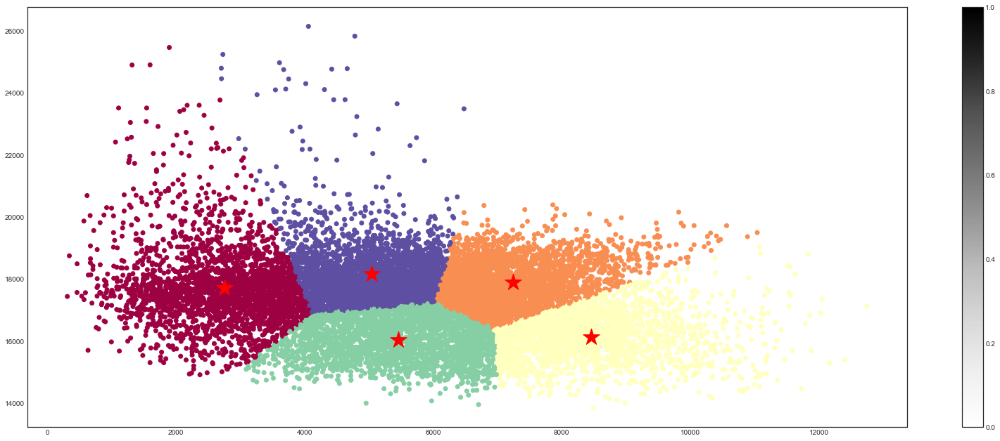

In [33]:
# Crossplot of KMeans clusters with Cluster centroid (Star symbol).
# Rms_Amplitude and AI varaiable are used from main data set, color coded with cluster 


plt.figure(figsize=(28,11))
plt.scatter(horizon.Rms_Amplitude, horizon.AI,c=horizon.cluster,cmap='Spectral')
plt.scatter(km.cluster_centers_[:,0] ,km.cluster_centers_[:,1], marker='*', s=600, c='r', label='centroid')
plt.colorbar()
plt.show()

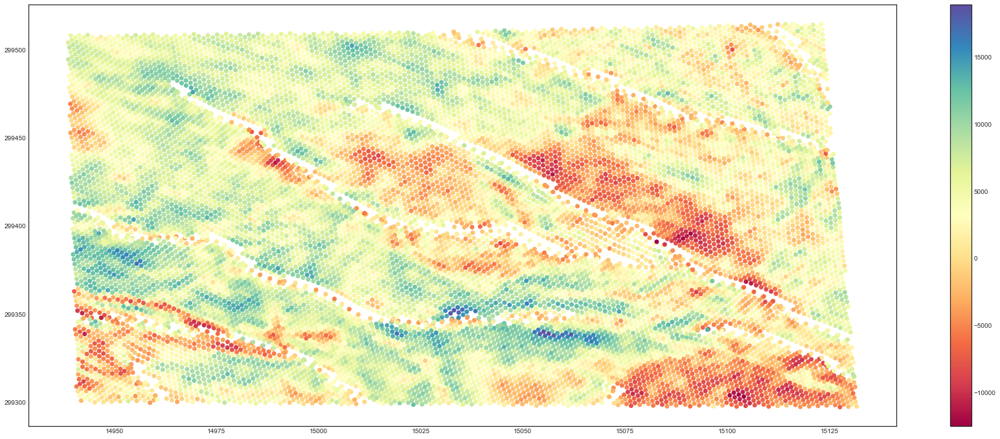

In [34]:
# Seismic amplitude map display with respect to X,Y location

plt.figure(figsize=(30,12))
plt.scatter(horizon.X,horizon.Y,c=horizon.Amplitude,cmap='Spectral')
plt.colorbar()
plt.show()

#### Figure 1a: Seismic Amplitude display 

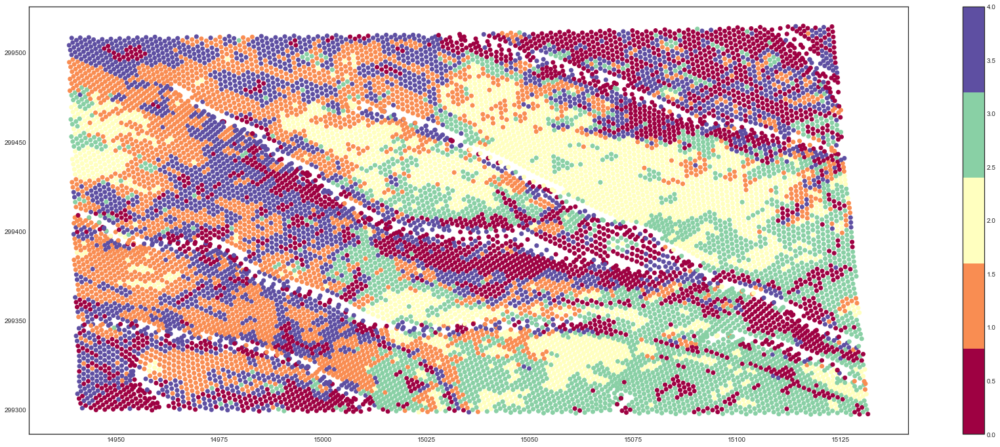

In [35]:
# Seismic KMeans clusters display with respect to X,Y location

plt.figure(figsize=(30,12))
plt.scatter(horizon.X,horizon.Y,c=horizon.cluster,cmap = plt.get_cmap('Spectral', np.max(horizon.cluster)-np.min(horizon.cluster)+1))
plt.colorbar()
plt.show()

#### Figure 1b: Seismic KMeans Clusters display

## Results
### Model Evaluation and Validation 
#### KMeans Clustering technique capture the seismic Red amplitude of interest as shown in the figure: Seismic Amplitude display but divide into two cluster (Blue and Magenta). we need to revise the number of clusters.

### To get the correct number of clusters I used Elbow plot method to find the corrected number of Clusters



## Elbow Plot

In [26]:
# For Elbow Plot, SSE is computed for 10 numbers of clusters 

k_range= range(1,10)
sse=[]
for k in k_range:
    kme=KMeans(n_clusters=k)
    kme.fit(strata)
    sse.append(kme.inertia_)
    
sse


[685342850663.0706,
 383598144867.1518,
 250721985654.1803,
 187868370404.27173,
 161553814237.08835,
 137101623170.95152,
 117955515426.567,
 106115565357.18474,
 95282464754.80736]

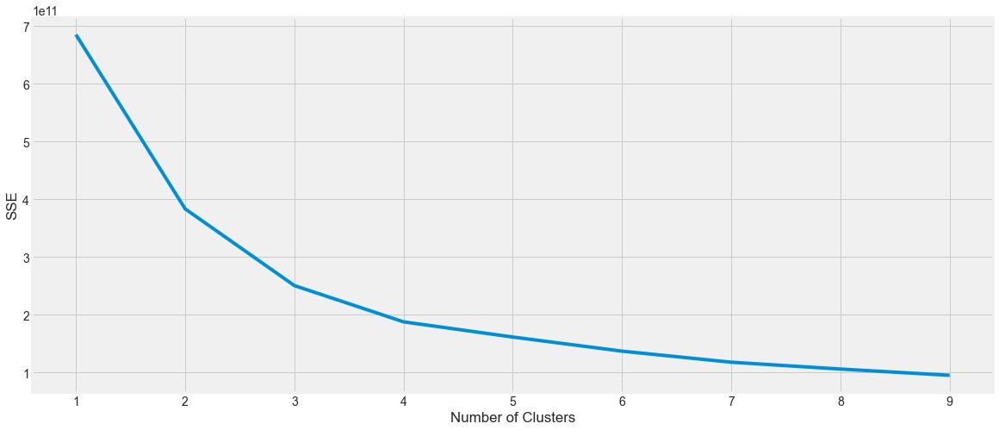

In [27]:
# Elbow plot creation 

plt.figure(figsize=(20,8))
plt.style.use("fivethirtyeight")
plt.xlabel("Number of Clusters")
plt.ylabel("SSE")
plt.plot(k_range, sse)

### On the basis of Elbow plot, I slected 4 Clusters (classes) for next Kmeans run

In [36]:
# Rescale all the variables to reduce MinMax values 


from sklearn.preprocessing import MinMaxScaler
scaler = StandardScaler()
strata_scaled = pd.DataFrame(scaler.fit_transform(strata), columns=strata.columns)
strata_scaled.head()

,Amplitude,Sweetness,Envople,Polarity,CosPhase,AI,Ampl_Contrast,Rms_Amplitude
0,-1.210361,-0.851160,-0.851160,-0.282561,-1.487855,0.314174,2.037119,-0.806622
1,-0.218159,-1.400098,-1.400098,-0.282561,0.517120,0.641975,0.788303,-1.145517
2,-0.011054,-1.044678,-1.044678,0.853288,0.585666,0.188585,1.662474,-1.390239
3,-0.330620,-1.821622,-1.821622,-0.282561,0.876988,0.388534,2.162000,-1.769639
4,-0.655266,-1.929684,-1.929684,-0.282561,-0.373980,0.746648,1.912237,-1.775330


In [37]:
# Kmeans Clustering run with 4 clusters on the basis of Elbow method


km1=KMeans(n_clusters=4)
km1

KMeans(n_clusters=4)

In [38]:
# Y variable predcition for scaled data by using all varaibles of Strata scaled data 

y1_predcited=km1.fit_predict(strata_scaled)
y1_predcited

array([1, 1, 1, ..., 1, 1, 1])

In [39]:
# km1 Centriod Values

km1.cluster_centers_

array([[-1.2407544 ,  0.49889934,  0.49889934, -0.41085827, -1.20115594,
        -1.03588875, -0.34297728,  0.58762886],
       [-0.45320686, -1.15958373, -1.15958373, -0.24983188, -0.22635801,
         0.32562888,  1.06270573, -1.12615858],
       [ 0.73083971,  0.48628826,  0.48628826, -0.28619753,  0.59058278,
         0.21662534, -0.50995839,  0.48484872],
       [ 0.87758954,  0.53102699,  0.53102699,  2.43639002,  0.68642788,
         0.2129495 , -0.46451176,  0.28516066]])

In [40]:
# Predicted Clusters are merged with Strata Sacled data 

strata_scaled['clusters1']=y1_predcited
strata_scaled.head(5)

,Amplitude,Sweetness,Envople,Polarity,CosPhase,AI,Ampl_Contrast,Rms_Amplitude,clusters1
0,-1.210361,-0.851160,-0.851160,-0.282561,-1.487855,0.314174,2.037119,-0.806622,1
1,-0.218159,-1.400098,-1.400098,-0.282561,0.517120,0.641975,0.788303,-1.145517,1
2,-0.011054,-1.044678,-1.044678,0.853288,0.585666,0.188585,1.662474,-1.390239,1
3,-0.330620,-1.821622,-1.821622,-0.282561,0.876988,0.388534,2.162000,-1.769639,1
4,-0.655266,-1.929684,-1.929684,-0.282561,-0.373980,0.746648,1.912237,-1.775330,1


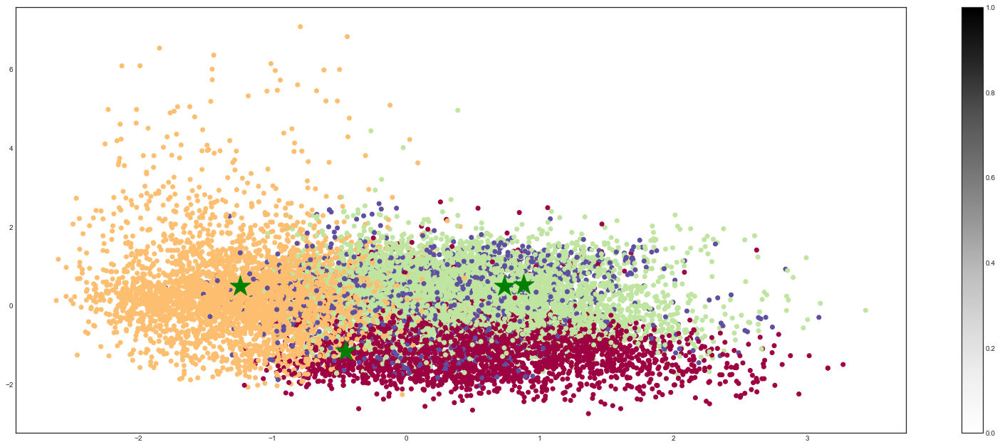

In [41]:
# Crossplot of KMeans clusters with Cluster centroid (Star symbol).
# Here luster are not center like previos image because here we used all varaibles of data
# Rms_Amplitude and AI varaiable are used from main data set, color coded with cluster

plt.figure(figsize=(28,11))
plt.scatter(strata_scaled.Rms_Amplitude, strata_scaled.AI,c=strata_scaled.clusters1,cmap='Spectral')
plt.scatter(km1.cluster_centers_[:,0] ,km1.cluster_centers_[:,1], marker='*', s=900, c='g', label='centroid')
plt.colorbar()
plt.show()

In [42]:
# Predicted Clusters are merged with main imported data (horizon)

horizon['cluster1']=y1_predcited

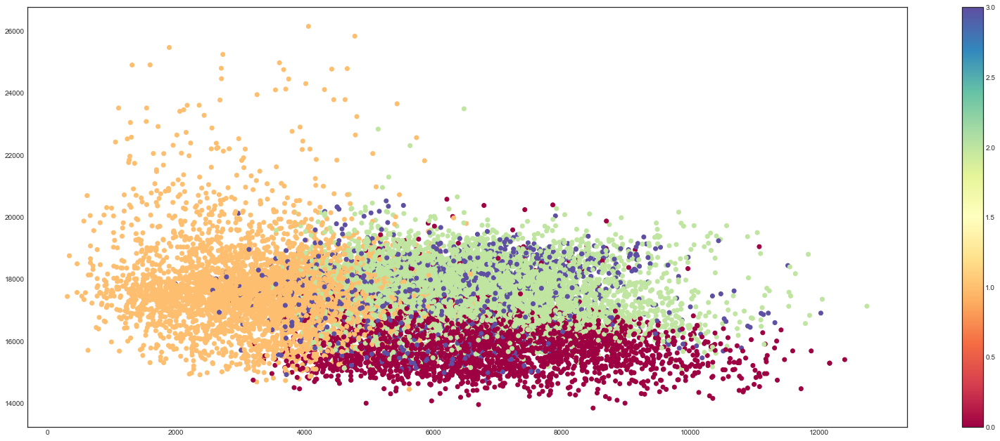

In [43]:
# Crossplot of KMeans clusters from the horiozn dataset
# Rms_Amplitude and AI varaiable are used from main data set, color coded with cluster

plt.figure(figsize=(28,11))
plt.scatter(horizon.Rms_Amplitude, horizon.AI,c=horizon.cluster1,cmap='Spectral')
plt.colorbar()
plt.show()

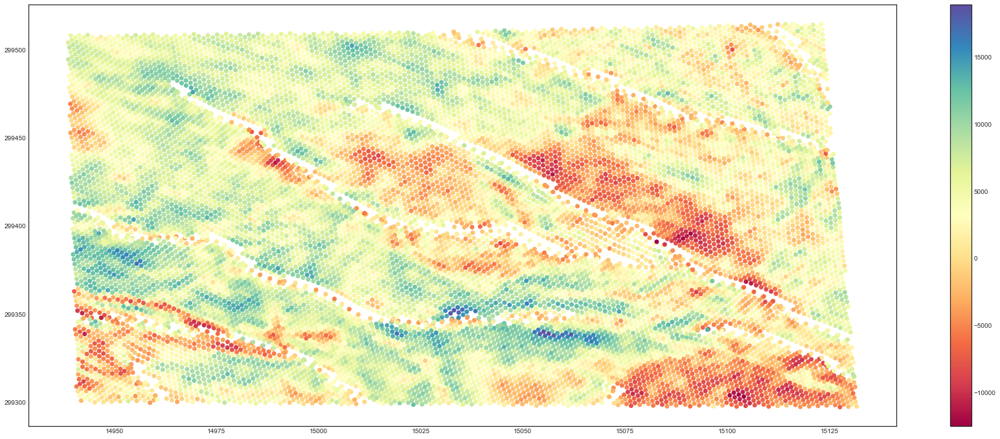

In [44]:
# Seismic amplitude map display with respect to X,Y location

plt.figure(figsize=(30,12))
plt.scatter(horizon.X,horizon.Y,c=horizon.Amplitude,cmap='Spectral')
plt.colorbar()
plt.show()

#### Figure 2a : Seismic amplitude display

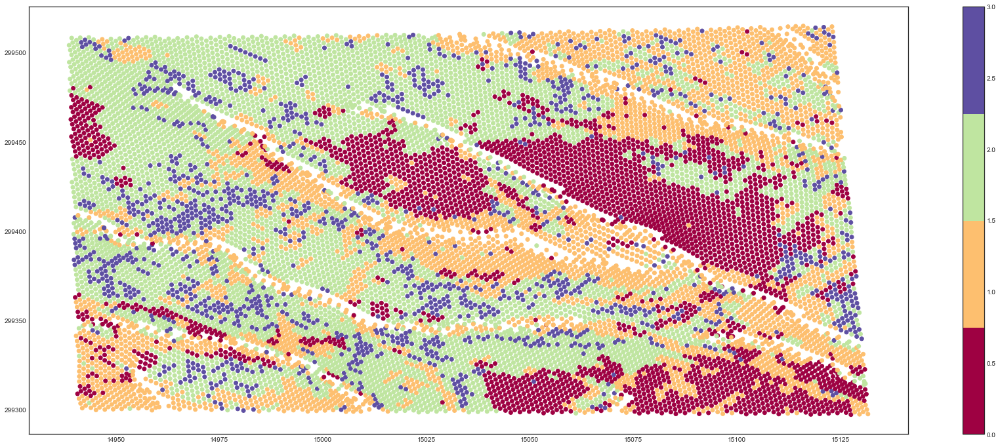

In [45]:
# Seismic KMeans clusters display with respect to X,Y location

plt.figure(figsize=(30,12))
plt.scatter(horizon.X,horizon.Y,c=horizon.cluster1,cmap = plt.get_cmap('Spectral', np.max(horizon.cluster1)-np.min(horizon.cluster1)+1))
plt.colorbar()
plt.show()

#### Figure 2b : Seismic KMeans Clusters display

## Results
### Model Evaluation and Validation 
#### KMeans Clustering technique with 4 clusters and all variables produced good results that captured the seismic Red amplitude of interest as a one cluster (blue), which helps to easily identify the sweet spot by incorporating all seismic attributes in quick way.

## Structural Analysis
#### In this task, KMeans clustering technique is used to revealed Faults and fractures that are not clear on data.


In [46]:
# Strcuture dataset display

structure.head()

,Dip,Azimuth,Variance,CosPhase,Ampl_Contrast
0,5.20,340.99,0.29,-0.45,0.48
1,5.17,5.53,0.10,0.72,0.38
2,6.17,340.95,0.22,0.76,0.45
3,5.59,334.10,0.34,0.93,0.49
4,5.07,326.89,0.23,0.20,0.47


In [47]:
# Rescale the structure dataset varaible before used to Kmeans Clustering

scaler = StandardScaler()
structure_scaled = pd.DataFrame(scaler.fit_transform(structure), columns=structure.columns)


In [48]:
# Elbow plot to find the number of clusters for Structure dataset 

k_range1= range(1,10)
sse1=[]
for k in k_range1:
    kmean=KMeans(n_clusters=k)
    kmean.fit(structure_scaled)
    sse1.append(kmean.inertia_)
    
sse1


[68005.00000000003,
 49600.63211786737,
 40707.054166606686,
 32295.97994731744,
 26021.219433261747,
 22653.766658006658,
 20660.003399367506,
 19179.328361263895,
 17893.053582991586]

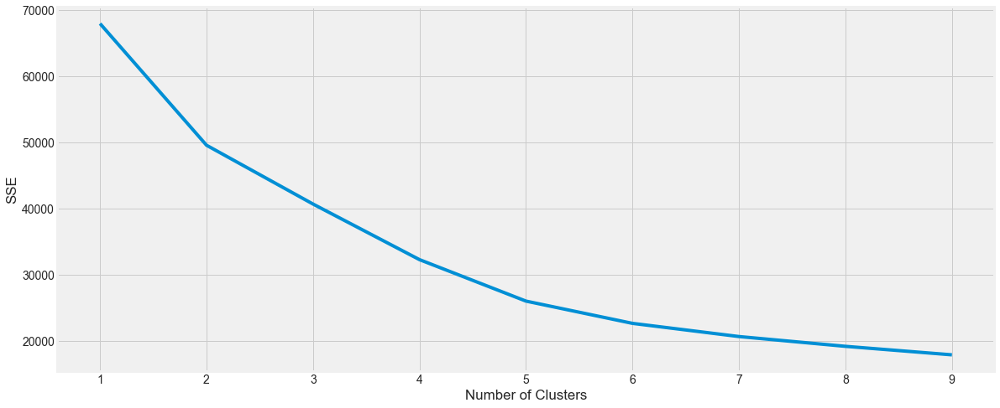

In [49]:
# Elbow plot for Structure dataset

plt.figure(figsize=(20,8))
plt.style.use("fivethirtyeight")
plt.xlabel("Number of Clusters")
plt.ylabel("SSE")
plt.plot(k_range1, sse1)

### On the basis of Elbow plot, 5 classes need to select but for structure analysis I selected two clusters. Here I am interested to find fault exist or not (two clusters). I can make more clusters for detailed analysis.

In [42]:
# KMeans Clustering for structural analysis for two clusters

km2=KMeans(n_clusters=2)
km2

KMeans(n_clusters=2)

In [43]:
# Predict the target varibale for Structure scaked dataset

y2_predcited=km2.fit_predict(structure_scaled)
y2_predcited

array([0, 1, 0, ..., 1, 0, 1])

In [44]:
# Merge predicted clusters with Structre scaled data
structure_scaled['clusters2']=y2_predcited
structure_scaled.head(5)

,Dip,Azimuth,Variance,CosPhase,Ampl_Contrast,clusters2
0,-0.160810,1.784464,2.297010,-1.487855,2.037119,0
1,-0.163931,-1.395748,0.338507,0.517120,0.788303,1
2,-0.059902,1.784085,1.575456,0.585666,1.662474,0
3,-0.120239,1.719146,2.812406,0.876988,2.162000,0
4,-0.174334,1.650794,1.678535,-0.373980,1.912237,0


In [45]:
# Merge predicted clusters with Main horizon dataset

horizon['cluster2']=y2_predcited

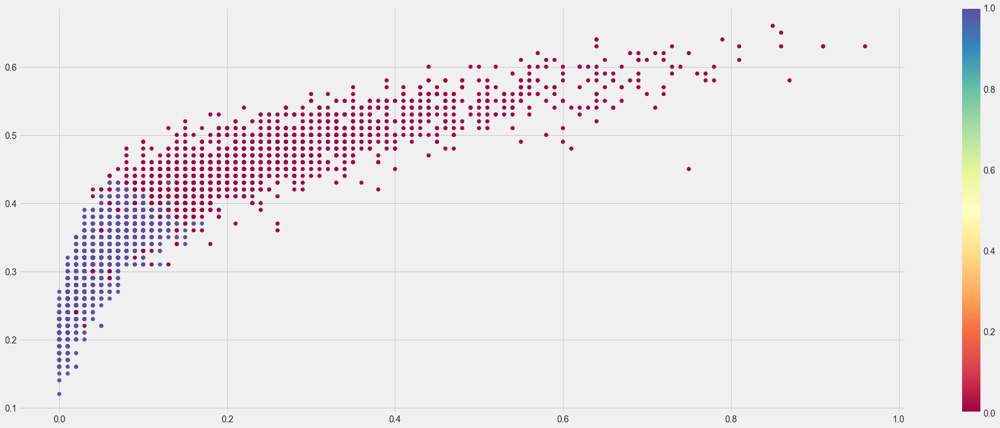

In [46]:
# Displayed the structure clusters analysis resulst with Horiozn Variance and Ampl_Contrast varaible

plt.figure(figsize=(28,11))
plt.scatter(horizon.Variance, horizon.Ampl_Contrast,c=horizon.cluster2,cmap='Spectral')
plt.colorbar()
plt.show()

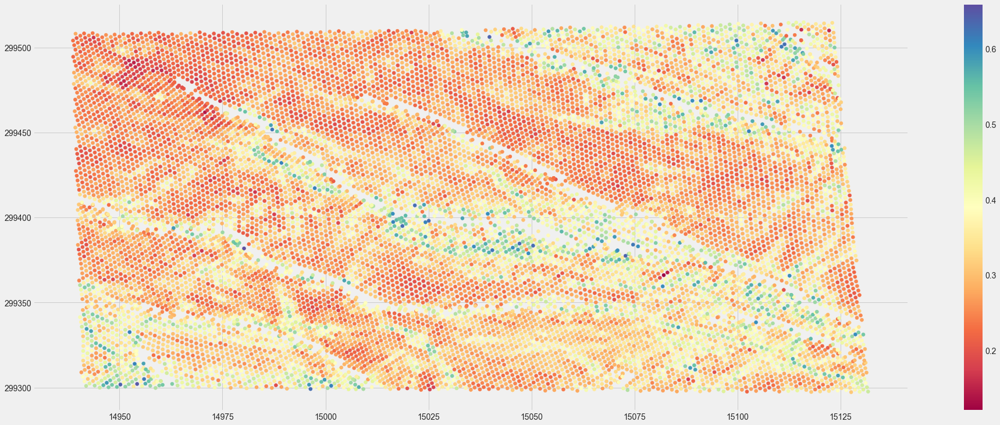

In [47]:
# Seismic amplitude display with respect to X,Y location

plt.figure(figsize=(30,12))
plt.scatter(horizon.X,horizon.Y,c=horizon.Ampl_Contrast,cmap='Spectral')
plt.colorbar()
plt.show()

#### Figure 3a : Seismic amplitude display

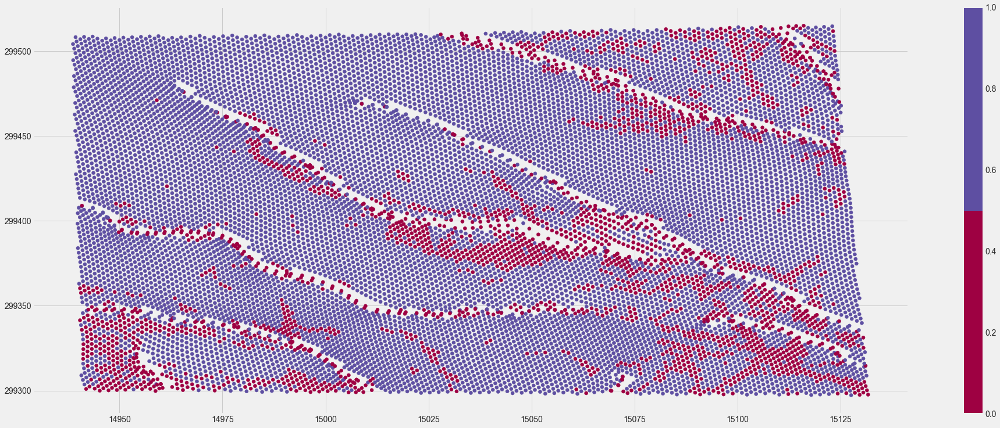

In [48]:
# Seismic KMeans strcutural analysis clusters display with respect to X,Y location

plt.figure(figsize=(30,12))
plt.scatter(horizon.X,horizon.Y,c=horizon.cluster2,cmap = plt.get_cmap('Spectral', np.max(horizon.cluster2)-np.min(horizon.cluster2)+1))
plt.colorbar()
plt.show()

#### Figure 3b : Structural analysis KMeans Clusterings display

## Results
### Model Evaluation and Validation 
#### KMeans Structural analysis Clustering technique with 2 clusters helps to identify the major fault (white color) and minor discontinuities (blue), which could be minor faults or fractures corridor zones. KMeans clustering technique using multiple structural related seismic attributes helps to reveal hidden structural elements from data.


## Supervised Machine Learning

### Implementation

#### There are many ML algorithms are available but I used SVM to predict facies using supervised learning technique. 


In [50]:
# Import Label data as CSV file

super_horizon=pd.read_csv('Supervised_Horizon_data.csv')
super_horizon.head()

,Number,X,Y,Depth,Dip,Azimuth,Amplitude,Sweetness,Variance,Envople,Polarity,CosPhase,AI,Ampl_Contrast,Rms_Amplitude,Facies,facies_labels
0,1,14941.8920,299300.9385,3302.34,5.20,340.99,-2360.61,5274.50,0.29,5274.50,0.00,-0.45,17672.24,0.48,4027.26,3,Slt
1,2,14957.5764,299337.5415,3166.59,1.42,222.14,-5160.13,5200.48,0.14,5200.48,-0.41,-0.99,18019.84,0.41,3312.61,3,Slt
2,3,14963.7100,299351.7345,3199.78,15.09,205.79,-2627.83,7163.48,0.03,7163.48,0.00,-0.37,18214.64,0.28,5482.13,3,Slt
3,4,14950.9888,299383.5885,3166.42,4.58,114.18,14401.76,14494.81,0.02,14494.81,0.72,0.99,18636.33,0.27,9162.21,4,ShSlt
4,5,15020.5272,299323.9290,3250.51,6.62,198.34,10330.06,10841.32,0.01,10841.32,-0.12,0.95,16661.43,0.25,6775.25,2,Fsand


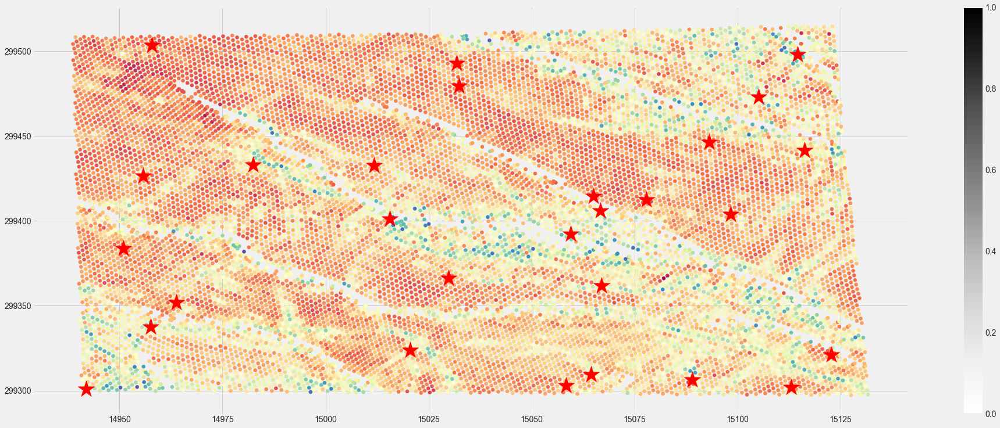

In [51]:
# Display label data (as Star) over previous impoted data (horizon)

plt.figure(figsize=(30,12))
plt.scatter(horizon.X,horizon.Y,c=horizon.Ampl_Contrast,cmap='Spectral')
plt.scatter(super_horizon.X,super_horizon.Y, marker='*', s=900, c='r')
plt.colorbar()
plt.show()

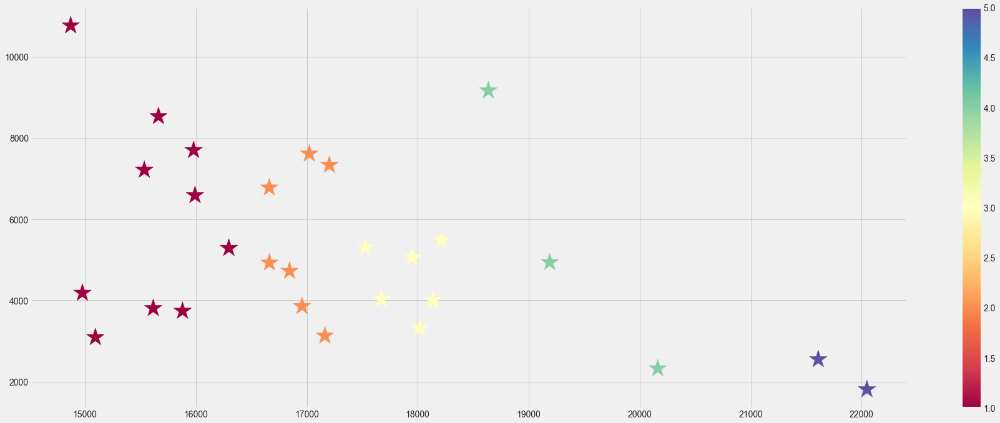

In [52]:
# Scatter plot of Label data. 

plt.figure(figsize=(28,11))
plt.scatter(super_horizon.AI, super_horizon.Rms_Amplitude,c=super_horizon.Facies,cmap='Spectral',marker='*', s=900)
plt.colorbar()
plt.show()

1    10
2     7
3     6
4     3
5     2
Name: Facies, dtype: int64

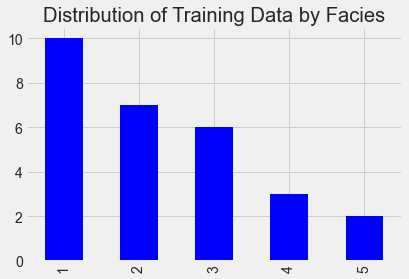

In [53]:
#Each facies count and sorted by facies number 

facies_counts = super_horizon['Facies'].value_counts().sort_index()

# Bar plot

facies_counts.plot(kind='bar',color= 'b', 
                   title='Distribution of Training Data by Facies')
facies_counts

In [54]:
# Just import again the train_test_split lib

from sklearn.model_selection import train_test_split


In [55]:
# Split the date to get the required column for classification analysis

X=super_horizon.iloc[:,[6,7,9,10,11,12,13,14,]] 
X.head()

,Amplitude,Sweetness,Envople,Polarity,CosPhase,AI,Ampl_Contrast,Rms_Amplitude
0,-2360.61,5274.50,5274.50,0.00,-0.45,17672.24,0.48,4027.26
1,-5160.13,5200.48,5200.48,-0.41,-0.99,18019.84,0.41,3312.61
2,-2627.83,7163.48,7163.48,0.00,-0.37,18214.64,0.28,5482.13
3,14401.76,14494.81,14494.81,0.72,0.99,18636.33,0.27,9162.21
4,10330.06,10841.32,10841.32,-0.12,0.95,16661.43,0.25,6775.25


In [56]:
# Import again the preprocessing lib

from sklearn import preprocessing

# Rescale the data

scaler = preprocessing.StandardScaler().fit(X)
scaled_X = scaler.transform(X)


In [57]:
# Create Taregt Y variable
y=super_horizon.Facies
y.head()

0    3
1    3
2    3
3    4
4    2
Name: Facies, dtype: int64

In [58]:
# Split data into training and test set 

X_train, X_test, y_train, y_test = train_test_split(scaled_X, y, test_size=0.4, random_state=42)

In [59]:
# To check the X variables number of points

len(X_train), len(X_test)


(16, 12)

In [60]:
# To check the Y variables number of points

len(y_train), len(y_test)

(16, 12)

In [61]:
# Train  the classifier

from sklearn import svm

clf = svm.SVC(C=50)
clf.fit(X_train,y_train)

SVC(C=50)

In [62]:
# Predict the target variable

predicted_labels = clf.predict(X_test)

In [63]:
# Test Score can be imporved using different values of C, Gamma and Kernal  in the equration clf = svm.SVC(C=..., Gamma, Kernal)

clf.score(X_test,y_test)  

0.5833333333333334

In [64]:
# Stratigraphic data set

strata.head()

,Amplitude,Sweetness,Envople,Polarity,CosPhase,AI,Ampl_Contrast,Rms_Amplitude
0,-2360.61,5274.50,5274.50,0.00,-0.45,17672.24,0.48,4027.26
1,2526.32,3523.99,3523.99,0.00,0.72,18082.52,0.38,3330.63
2,3546.38,4657.39,4657.39,0.32,0.76,17515.05,0.45,2827.58
3,1972.41,2179.79,2179.79,0.00,0.93,17765.31,0.49,2047.69
4,373.42,1835.19,1835.19,0.00,0.20,18213.53,0.47,2035.99


In [65]:
# Make a copy of Starta dataset for prescition 

strata_predict = strata
strata_predict.head()

,Amplitude,Sweetness,Envople,Polarity,CosPhase,AI,Ampl_Contrast,Rms_Amplitude
0,-2360.61,5274.50,5274.50,0.00,-0.45,17672.24,0.48,4027.26
1,2526.32,3523.99,3523.99,0.00,0.72,18082.52,0.38,3330.63
2,3546.38,4657.39,4657.39,0.32,0.76,17515.05,0.45,2827.58
3,1972.41,2179.79,2179.79,0.00,0.93,17765.31,0.49,2047.69
4,373.42,1835.19,1835.19,0.00,0.20,18213.53,0.47,2035.99


In [66]:
# Rescaled data using the same constants we used for the training data.

X_unknown = scaler.transform(strata_predict)

In [67]:
# Facies predcition for Strata_prediction dataset

y_unknown = clf.predict(X_unknown)

strata_predict['Facies'] = y_unknown
strata_predict.head()

<ipython-input-67-baf540206d12>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  strata_predict['Facies'] = y_unknown


,Amplitude,Sweetness,Envople,Polarity,CosPhase,AI,Ampl_Contrast,Rms_Amplitude,Facies
0,-2360.61,5274.50,5274.50,0.00,-0.45,17672.24,0.48,4027.26,2
1,2526.32,3523.99,3523.99,0.00,0.72,18082.52,0.38,3330.63,2
2,3546.38,4657.39,4657.39,0.32,0.76,17515.05,0.45,2827.58,2
3,1972.41,2179.79,2179.79,0.00,0.93,17765.31,0.49,2047.69,2
4,373.42,1835.19,1835.19,0.00,0.20,18213.53,0.47,2035.99,4


In [68]:
# Add predicted facies in Main horiozn dataset

horizon['Facies']=y_unknown

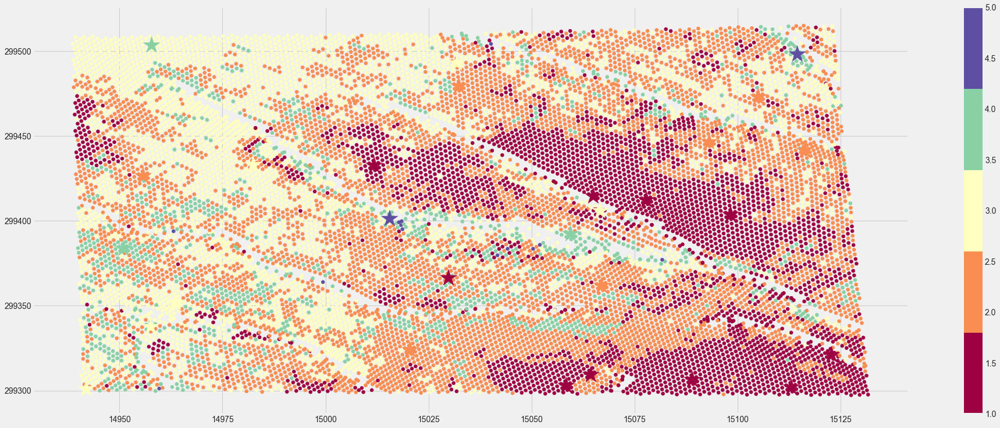

In [69]:
# Predicted Facies display using USM model with X,Y locations

plt.figure(figsize=(30,12))
plt.scatter(horizon.X,horizon.Y,c=horizon.Facies,cmap = plt.get_cmap('Spectral', np.max(horizon.Facies)-np.min(horizon.Facies)+1))
plt.scatter(super_horizon.X, super_horizon.Y,c=super_horizon.Facies,cmap = plt.get_cmap('Spectral', np.max(horizon.Facies)-np.min(horizon.Facies)+1),marker='*', s=900)
plt.colorbar()
plt.show()

#### Figure 4a : SVM predcited facies (Clusters) display

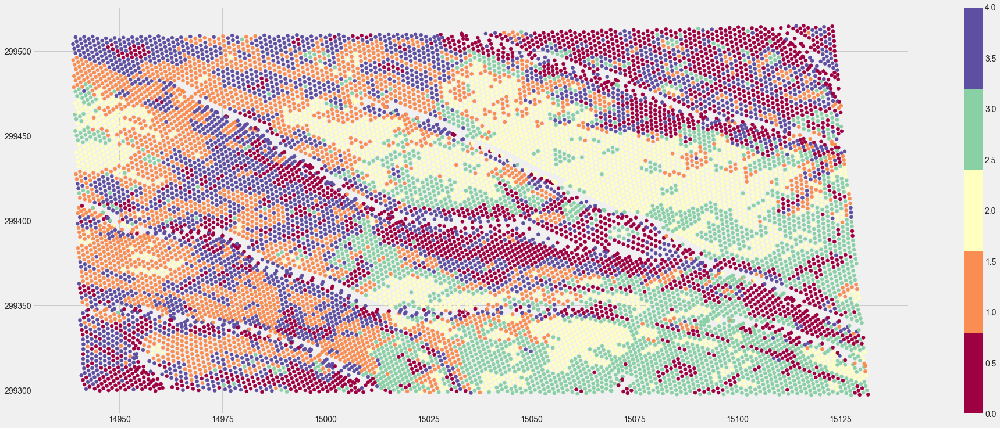

In [70]:
# Predicted cluster using KMeans model  display with X,Y locations

plt.figure(figsize=(30,12))
plt.scatter(horizon.X,horizon.Y,c=horizon.cluster,cmap = plt.get_cmap('Spectral', np.max(horizon.cluster)-np.min(horizon.cluster)+1))
plt.colorbar()
plt.show()

#### Figure 4b : KMeans Clusterings (4clusters) display

## Results
### Model Evaluation and Validation 
#### SVM classifier results are better than KMeans predcition but still some places at label points wrong cluster predcition. 
#### Need to refine model by reducing the number of variables to imporve the prediction

In [71]:
# Label data display 
super_horizon.head()

,Number,X,Y,Depth,Dip,Azimuth,Amplitude,Sweetness,Variance,Envople,Polarity,CosPhase,AI,Ampl_Contrast,Rms_Amplitude,Facies,facies_labels
0,1,14941.8920,299300.9385,3302.34,5.20,340.99,-2360.61,5274.50,0.29,5274.50,0.00,-0.45,17672.24,0.48,4027.26,3,Slt
1,2,14957.5764,299337.5415,3166.59,1.42,222.14,-5160.13,5200.48,0.14,5200.48,-0.41,-0.99,18019.84,0.41,3312.61,3,Slt
2,3,14963.7100,299351.7345,3199.78,15.09,205.79,-2627.83,7163.48,0.03,7163.48,0.00,-0.37,18214.64,0.28,5482.13,3,Slt
3,4,14950.9888,299383.5885,3166.42,4.58,114.18,14401.76,14494.81,0.02,14494.81,0.72,0.99,18636.33,0.27,9162.21,4,ShSlt
4,5,15020.5272,299323.9290,3250.51,6.62,198.34,10330.06,10841.32,0.01,10841.32,-0.12,0.95,16661.43,0.25,6775.25,2,Fsand


In [72]:
# Only selected 4 varaibles for SVM second run the basis of previous crossplots and histrogram analysis

# X traing data for 2nd run

X2nd=super_horizon.iloc[:,[6,7,12,14,]] 
X2nd.head()

,Amplitude,Sweetness,AI,Rms_Amplitude
0,-2360.61,5274.50,17672.24,4027.26
1,-5160.13,5200.48,18019.84,3312.61
2,-2627.83,7163.48,18214.64,5482.13
3,14401.76,14494.81,18636.33,9162.21
4,10330.06,10841.32,16661.43,6775.25


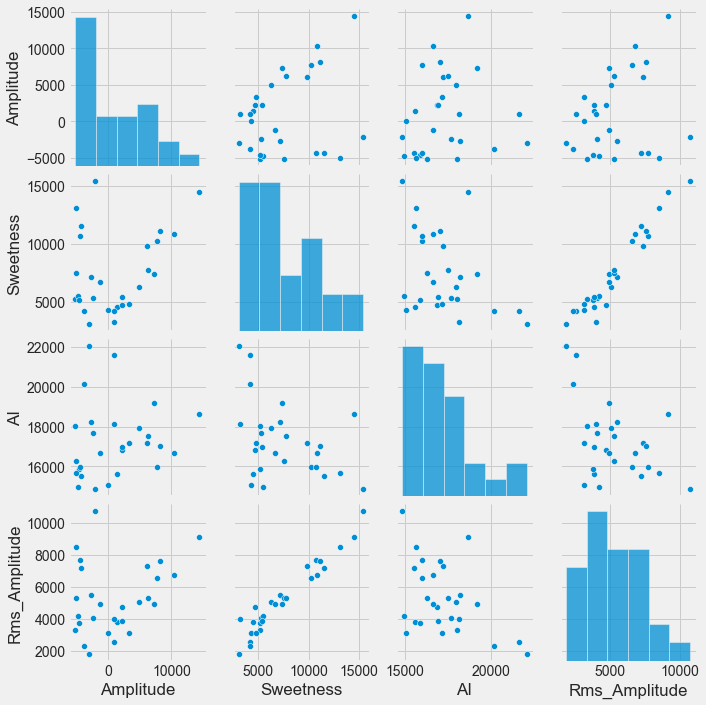

In [73]:
# Seaborn Lin used to create pairplot 

sns.pairplot(X2nd)

In [74]:
# Target dataset creation

y2nd=super_horizon.Facies
y2nd.head()

0    3
1    3
2    3
3    4
4    2
Name: Facies, dtype: int64

In [75]:
# Rescale the data
scaler2nd = preprocessing.StandardScaler().fit(X2nd)
scaled_X2nd = scaler2nd.transform(X2nd)

In [76]:
# Split the data in training and Test set

X2nd_train, X2nd_test, y2nd_train, y2nd_test = train_test_split(scaled_X2nd, y2nd, test_size=0.4, random_state=42)

In [77]:
# # Train  the classifier

from sklearn import svm

# SVM model

clf1 = svm.SVC(C=50)
clf1.fit(X2nd_train,y2nd_train)

SVC(C=50)

In [78]:
# Target varibale prediction using model

predicted_labels = clf1.predict(X2nd_test)

In [79]:
# Dataset preparation for predcition

strata_predict2nd = horizon.iloc[:,[6,7,12,14,]]
strata_predict2nd.head()

,Amplitude,Sweetness,AI,Rms_Amplitude
0,-2360.61,5274.50,17672.24,4027.26
1,2526.32,3523.99,18082.52,3330.63
2,3546.38,4657.39,17515.05,2827.58
3,1972.41,2179.79,17765.31,2047.69
4,373.42,1835.19,18213.53,2035.99


In [80]:
# Rescaled data using the same constants we used for the training data.

X2nd_unknown = scaler2nd.transform(strata_predict2nd)

In [81]:
# Facies predcition for Strata_prediction2nd dataset

y2nd_unknown = clf1.predict(X2nd_unknown)
strata_predict2nd['Facies'] = y2nd_unknown
strata_predict2nd.head()

<ipython-input-81-6a18f52fe0dd>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  strata_predict2nd['Facies'] = y2nd_unknown


,Amplitude,Sweetness,AI,Rms_Amplitude,Facies
0,-2360.61,5274.50,17672.24,4027.26,2
1,2526.32,3523.99,18082.52,3330.63,3
2,3546.38,4657.39,17515.05,2827.58,2
3,1972.41,2179.79,17765.31,2047.69,1
4,373.42,1835.19,18213.53,2035.99,3


In [82]:
# Add predicted facies to Main horiozn dataset

horizon['Facies2']= y2nd_unknown

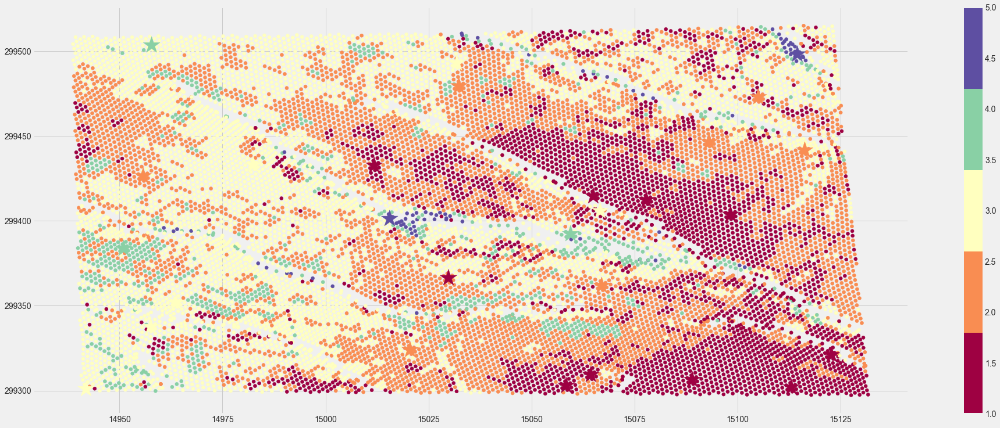

In [83]:
# Predicted Facies display using refine SVM model with X,Y locations

plt.figure(figsize=(30,12))
plt.scatter(horizon.X,horizon.Y,c=horizon.Facies2,cmap = plt.get_cmap('Spectral', np.max(horizon.Facies)-np.min(horizon.Facies)+1))
plt.scatter(super_horizon.X, super_horizon.Y,c=super_horizon.Facies,cmap = plt.get_cmap('Spectral', np.max(horizon.Facies)-np.min(horizon.Facies)+1),marker='*', s=900)
plt.colorbar()
plt.show()

## Results
### Model Evaluation and Validation 
#### SVM refine model results are improved by reducing the number of variables.
#### Still few label points are not predicted well but mostly label points exist in the zone of interest predicted accurately.



## Conclusion:

#### KMeans and SVM classifiers help to reveal the hidden stratigraphic and structure features from multiple number of seismic attributes. Python data analytic analysis (Histogram, scatterplot, Matrix plot) enables to find the correlation and dependency of different seismic attributes on each other to feed right set of attributes to ML classifier to get valuable information from data to identify sweet spot for oil and gas exploration and field development. 

#### All the ML techniques that I gained in this Nanodegree will help me to automate and reveal the maximum information from the geological and geophysics data. It also provides me new dimension how to view data and get utilize in proper way. 

## Way Forward or Improvement: 
#### We can improve the results using other classifer or pycaret lib which helps to run all classifier in one go and select the best accuracy model